In [ ]:
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime, timedelta
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
import joblib
import tensorflow as tf
from keras.models import Sequential
from keras.models import Model
import keras.layers
from keras.layers import Dense, Input, LSTM, Concatenate, LeakyReLU
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from math import sqrt
from matplotlib import pyplot
from numpy import array, concatenate
import numpy as np
import os

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# convert time series into supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, n_features = 1,
                         pred_id = 0, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
        if i == 0:
            names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
        else:
            names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # put it all together
    agg = concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    
    # Drop non-predicting variables
    drop_cols = list(set(range(-n_features*n_out,0)) - \
                set([(-(i+1)*n_features) for i in range(n_out)]))
    
    agg = agg.drop(agg.columns[drop_cols], axis=1)
    return agg

In [ ]:
# transform series into train and test sets for supervised learning
def prepare_data(series, n_test, n_lag, n_seq, n_features, pred_id=0):
    # extract raw values
    raw_values = series.values
    raw_values = raw_values.reshape(len(raw_values), -1)
    print(raw_values.shape)
    
    # rescale values to -1, 1
    scaler = MinMaxScaler(feature_range=(-1, 1))
    scaled_values = scaler.fit_transform(raw_values)
    scaled_values = scaled_values.reshape(len(scaled_values), -1)
    # transform into supervised learning problem X, y
    supervised = series_to_supervised(scaled_values, n_lag, n_seq,
                                      n_features=n_features, 
                                      pred_id=pred_id)
    supervised_values = supervised.values
    # split into train and test sets
    train, test = supervised_values[0:-n_test], supervised_values[-n_test:]
    return scaler, train, test

In [ ]:
# transform series into train and test sets for supervised learning
def prepare_all_state_data(states, series, n_test, n_lag, n_seq, 
                           nth_week, n_features, n_out=7, pred_id=0):
    train = np.empty((0, n_lag*n_features+n_seq))
    test = np.empty((0, n_lag*n_features+n_seq))
    
    for state in states:
        state_df = series[series['location_name']==state]
        state_df = state_df.drop(['location','location_name', 
                                  'hospitalizations', 'cases'], axis=1)
        # 'spc', 'adj_cov_gst', 'sm_sym_gst'

        state_supervised = series_to_supervised(state_df, n_in=n_lag, n_out=n_seq,
                                            n_features=n_features, pred_id=0)
        state_supervised_values = state_supervised.values
        state_train, state_test = state_supervised_values[0:-n_test], state_supervised_values[-n_test:]
        
        train_unclean = np.append(train, state_train, axis=0)
        test = np.append(test, state_test, axis=0)
        # all_state_supervised = all_state_supervised.append(state_supervised)
        # print(f'{state} is statcked in DataFrame.')
    
        # print(train.shape, test.shape)
        # # Clean up all data for validation
        train = train_unclean[:-(n_out*nth_week) + 1, :] # if -(n_out*nth_week)+2, leaking first day
    print('Deleted rows: ', n_out*nth_week)
    print('Uncleaned Train shape: ', (len(states)*(state_supervised.shape[0]-1),
                                      state_supervised.shape[1]))
    print('Cleaned Train shape: ', train.shape)
        
    raw_values = np.concatenate((train, test), axis=0)
    print(f'Concatenated Dataframe shape: {raw_values.shape}')
    print(raw_values[1,-(nth_week+1)*n_out:])
    if nth_week >= 2:
        raw_values = np.delete(raw_values, np.s_[n_features*n_lag: n_features*n_lag+n_out*(nth_week-1)], axis=1)
    print(f'Concatenated Dataframe shape of {nth_week}th week: {raw_values.shape}')
    print(raw_values[1,-2*n_out:])
    # # rescale values to -1, 1
    scaler = MinMaxScaler(feature_range=(-1, 1))
    scaled_values = scaler.fit_transform(raw_values)
    scaled_values = scaled_values.reshape(len(scaled_values), -1)
    
    # split into train and test sets
    train, test = scaled_values[0:-len(test)], scaled_values[-len(test):]
    return scaler, train, test

In [ ]:
class MultiQuantileLoss(tf.keras.losses.Loss):
    
    def __init__(self, quantiles:list, **kwargs):
        super(MultiQuantileLoss, self).__init__(**kwargs)
        
        self.quantiles = quantiles

    def call(self, y_true, y_pred):
        
        # get quantile value
        q_id = int(y_pred.name.split("/")[1][1:])
        q = self.quantiles[q_id]
        
        # minimize quantile error
        q_error = tf.subtract(y_true, y_pred)
        q_loss = tf.reduce_mean(tf.maximum(q*q_error, (q-1)*q_error), axis=-1)
        return q_loss

In [ ]:
# fit an LSTM network to training data
def fit_lstm(train, n_lag, n_features, 
             n_seq, n_batch, nb_epoch, 
             n_neurons):
    
    # quantiles = [.1, .5, .9]
    quantiles = [.025, .100, .250, .500, .750, .900, .975]
    # quantiles = [.010, .025, .050, .100, .150, .200, .250, .300, .350, .400, .450, .500,
    #              .550, .600, .650, .700, .750, .800, .850, .900, .950, .975, .990]

    # reshape training into [samples, timesteps, features]
    X, y = train[:, 0:n_lag*n_features], train[:, n_lag*n_features:]
    X = X.reshape(X.shape[0], n_lag, n_features)
    # design network
    model = Sequential()
    model.add(LSTM(n_neurons, activation='tanh',
                   return_sequences=True,
                   input_shape=(X.shape[1], X.shape[2])))
    model.add(LSTM(n_neurons, activation='tanh'))
    model.add(Dense(y.shape[1]))
    # loss=tf.keras.losses.Huber(),mae, mse
    model.compile(loss=tf.keras.losses.Huber(), optimizer='adam') 
    # fit network
    history = model.fit(X, y, epochs=nb_epoch, 
                        batch_size=n_batch,  
                        verbose=2, shuffle=False)
    
    return model

In [ ]:
# fit an LSTM network to training data
def fit_lstm_quantile(train1, train2, n_lag1, n_lag2, 
                      n_features, n_out, n_batch, nb_epoch, 
                      n_neurons, val=False, val_1=None, val_2=None):
    # quantiles = [.025, .100, .250, .500, .750, .900, .975]
    # quantiles = [.050, .500, .950]
    quantiles = [.010, .025, .050, .100, .150, .200, .250, .300, .350, .400, .450, .500,
                 .550, .600, .650, .700, .750, .800, .850, .900, .950, .975, .990]
    output_dim = len(quantiles)
    print(output_dim)
    outputs = []

    # Define a learnable weights
    W = tf.Variable(1.0, trainable=True)

    # reshape training into [samples, timesteps, features]
    X1, y1 = train1[:, 0:n_lag1*n_features], train1[:, n_lag1*n_features:]
    X1 = X1.reshape(X1.shape[0], n_lag1, n_features)
    # reshape training into [samples, timesteps, features]
    X2, y2 = train2[:, 0:n_lag2*n_features], train2[:, n_lag2*n_features:]
    X2 = X2.reshape(X2.shape[0], n_lag2, n_features)

    # design network
    ts_input1 = Input((X1.shape[1], X1.shape[2]))
    lstm1_1_out = LSTM(int(n_neurons), activation="tanh", return_sequences=True)(ts_input1)
    lstm1_2_out = LSTM(int(n_neurons/2), activation="tanh", return_sequences=True)(lstm1_1_out)
    lstm1_3_out = LSTM(int(n_neurons/2), activation='tanh', return_sequences=True)(lstm1_2_out)
    lstm1_4_out = LSTM(int(n_neurons/2), activation='tanh')(lstm1_3_out)
    # lstm1_4_out = LSTM(int(n_neurons/2), activation='tanh')(lstm1_3_out)
    map_lstm1 = Dense(64)(lstm1_4_out)

    # design network
    ts_input2 = Input((X2.shape[1], X2.shape[2]))
    lstm2_1_out = LSTM(int(n_neurons), activation="tanh", return_sequences=True)(ts_input2)
    lstm2_2_out = LSTM(int(n_neurons/2), activation="tanh", return_sequences=True)(lstm2_1_out)
    lstm2_3_out = LSTM(int(n_neurons/2), activation='tanh', return_sequences=True)(lstm2_2_out)
    lstm2_4_out = LSTM(int(n_neurons/2), activation='tanh')(lstm2_3_out)
    # lstm2_4_out = LSTM(int(n_neurons/2), activation='tanh')(lstm2_3_out)
    map_lstm2 = Dense(64)(lstm2_4_out)

    # Concatenate LSTMs
    #lstm_2_out = keras.layers.concatenate([w * map_lstm1, map_lstm2])
    lstm_2_out = keras.layers.Concatenate()([W*map_lstm1, map_lstm2])
    print(f'W: {W}')
    #dense_1_out = Dense(96)(lstm_2_out)
    
#     # create an output for each quantile
#     for i,quantile in enumerate(quantiles):
#         output = Dense(y.shape[1], name="q_"+str(i))(dense_1_out)
#         outputs.append(output)
    outputs = [Dense(n_out, activation='linear', name="q%d" % q_i)(lstm_2_out) for q_i in range(output_dim)]


    # loss
    q_loss = MultiQuantileLoss(quantiles)

    # intialize & compile
    model = Model(inputs=[ts_input1, ts_input2], outputs=outputs)

    # Set Learning rate decay for AdamOpt
    initial_lr = 0.0008 # Default for adam is 0.001
    # lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    #     initial_lr,
    #     decay_steps=3000,
    #     decay_rate=0.96,
    #     staircase=True
    #     )
    Adam_Opt = tf.keras.optimizers.Adam(initial_lr)

    # Compile the model
    model.compile(optimizer=Adam_Opt, loss=q_loss.call)
    # Huber Loss
    # model.compile(optimizer=Adam_Opt, loss=tf.keras.losses.Huber())
    
    print(y1.shape)
    logdir = os.path.join("logs", datetime.now().strftime("%Y%m%d-%H%M%S"))
    tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

    # patient early stopping
    es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=10, 
                       restore_best_weights=False) 


    if val != False:
      print('Has Validation!')
      # Random Validation
      if val == 'Random':
        print('Random Validation Split!')
        val_pct = 0.05
        # Validation Preparation
        ## Preparing for validation set
        val_idx = np.random.randint(0, len(train1), int(val_pct*len(train1)))
        
        # val_1 = train1[val_idx]
        # val_2 = train2[val_idx]

        # train1 = np.delete(train1, val_idx, axis=0)
        # train2 = np.delete(train2, val_idx, axis=0)

        # val_1, val_2 = train1[-1,], train2[-1,]
        val_X1, val_y = val_1[:, 0:n_lag1*n_features], val_1[:, n_lag1*n_features:]
        val_X1 = val_X1.reshape((val_X1.shape[0], n_lag1, n_features))

        val_X2, val_y = val_2[:, 0:n_lag2*n_features], val_2[:, n_lag2*n_features:]
        val_X2 = val_X2.reshape((val_X2.shape[0], n_lag2, n_features))

        # fit network
        history = model.fit([X1, X2], y1, epochs=nb_epoch, 
                            batch_size=n_batch,  
                            verbose=2, shuffle=False, 
                            # validation_split=0.01,
                            validation_data=([val_X1, val_X2], val_y), 
                            callbacks=[tensorboard_callback, es])
      elif val == 'Recent':
        print('Recent Validation Split!')
        train_idx = []
        for i in range(51):
          for j in range(51):
            train_idx = train_idx + [int(i + (j * train1.shape[0] / 51))]
        
        train1 = train1[train_idx]
        train2 = train2[train_idx]

        # fit network
        history = model.fit([X1, X2], y1, epochs=nb_epoch, 
                            batch_size=n_batch,  
                            verbose=2, shuffle=False, 
                            validation_split=0.05,
                            # validation_data=([val_X1, val_X2], val_y), 
                            callbacks=[tensorboard_callback, es])
      else:
        print('Default (State) Validation Split!')
        print(f'Validation Pct. : {val}')
        # Default Validation Split 
        # Last state's data as validation
        # Validation Preparation
        ## Preparing for validation set
        # val_idx = [int((-1) - n * (train1.shape[0] / 51 )) for n in range(51)]

        # train1 = np.delete(train1, val_idx, axis=0)
        # train2 = np.delete(train2, val_idx, axis=0)

        # val_1 = train1[val_idx]
        # val_2 = train2[val_idx]
        # # val_1, val_2 = train1[-1,], train2[-1,]
        # val_X1, val_y = val_1[:, 0:n_lag1*n_features], val_1[:, n_lag1*n_features:]
        # val_X1 = val_X1.reshape((val_X1.shape[0], n_lag1, n_features))

        # val_X2, val_y = val_2[:, 0:n_lag2*n_features], val_2[:, n_lag2*n_features:]
        # val_X2 = val_X2.reshape((val_X2.shape[0], n_lag2, n_features))
        
        # fit network
        history = model.fit([X1, X2], y1, epochs=nb_epoch, 
                            batch_size=n_batch,  
                            verbose=2, shuffle=False, 
                            validation_split=val,
                            #validation_data=([val_X1, val_X2], val_y), 
                            callbacks=[tensorboard_callback, es])
    else:
      print('No Validation!')
      history = model.fit([X1, X2], y1, epochs=nb_epoch, 
                          batch_size=n_batch,  
                          verbose=2, shuffle=False,  
                          callbacks=[tensorboard_callback, es])
    

    return model

In [ ]:
# evaluate the persistence model
def make_forecasts(model, n_batch, test1, test2, 
                   n_features, n_lag1, n_lag2, n_seq):
    test_X1, test_y = test1[:, 0:n_lag1*n_features], test1[:, n_lag1*n_features:]
    test_X1 = test_X1.reshape((test_X1.shape[0], n_lag1, n_features))

    test_X2, test_y = test2[:, 0:n_lag2*n_features], test2[:, n_lag2*n_features:]
    test_X2 = test_X2.reshape((test_X2.shape[0], n_lag2, n_features))

    forecasts = model.predict([test_X1, test_X2], batch_size=n_batch)
    # print(forecasts.shape)
    
    return forecasts

In [ ]:
# inverse data transform on forecasts
def inverse_transform(test, forecasts, scaler, 
                      n_lag, n_features):
    test_X, test_y = test[:, 0:n_lag*n_features], test[:, n_lag*n_features:]    
    inverted_hat = np.zeros(shape=forecasts.shape)
    inverted_truth = np.zeros(shape=test_y.shape)
    for i in range(forecasts.shape[1]):
        # Inverse predictions
        y_hat_i = forecasts[:,[i]]
        inv_yhat_i = concatenate((y_hat_i, test_X[:, -(n_features-1):]), axis=1)
        inv_yhat_i = scaler.inverse_transform(inv_yhat_i)
        inv_yhat_i = inv_yhat_i[:,[0]]
        
        # store
        inverted_hat[:,[i]] = inv_yhat_i
        
        # Inverse Ground Truth
        y_i = test_y[:,[i]]
        inv_y_i = concatenate((y_i, test_X[:, -(n_features-1):]), axis=1)
        inv_y_i = scaler.inverse_transform(inv_y_i)
        inv_y_i = inv_y_i[:,[0]]
        
        # store
        inverted_truth[:,[i]] = inv_y_i
    return inverted_hat, inverted_truth

In [ ]:
# inverse data transform on forecasts
def inverse_transform_all_state(test, forecasts, scaler, 
                                n_lag, n_features, n_seq, quantile_i):
    test_X, test_y = test[:, 0:n_lag*n_features], test[:, n_lag*n_features:]    
    # print(test_X.shape, test_y.shape)
    forecasts_median = forecasts[quantile_i]
    inverted_hat = concatenate((test_X, forecasts_median), axis=1)
    inverted_hat = scaler.inverse_transform(inverted_hat)
    inverted_hat = inverted_hat[:, -n_seq:]
    
    inverted_truth = scaler.inverse_transform(test)
    inverted_truth = inverted_truth[:, -n_seq:]
    
    return inverted_hat, inverted_truth

In [ ]:
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    mae_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        
        np_actual = np.array(actual)
        np_predicted = np.array(predicted)
        mae = mean_absolute_error(actual, predicted)
        mape = np.mean(np.abs((np_actual - np_predicted) / actual)) * 100
        rmse = sqrt(mean_squared_error(actual, predicted))
        
        mae_list.append(mae)
        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('==============================')
        
    return mae_list

In [ ]:
# Export forecasts according to Hub's format
# Input: inv_forecast = [np.array(num_state, num_day_forecast) * 23_quantile]
def export_forecasts(inv_forecast, date, n_seq, states_list, train_date):
    # output name format = YYYY-MM-DD-team-model.csv
    output_name = date.strftime('%Y-%m-%d') + '-' + 'CUBoulder' + '-' + 'SLSTM_214_11.csv'

    # Define fips to state
    fip_state = {
        "01": "Alabama",
        "02": "Alaska",
        "04": "Arizona",
        "05": "Arkansas",
        "06": "California",
        "08": "Colorado",
        "09": "Connecticut",
        "10": "Delaware",
        "11": "District of Columbia",
        "12": "Florida",
        "13": "Georgia",
        "15": "Hawaii",
        "16": "Idaho",
        "17": "Illinois",
        "18": "Indiana",
        "19": "Iowa",
        "20": "Kansas",
        "21": "Kentucky",
        "22": "Louisiana",
        "23": "Maine",
        "24": "Maryland",
        "25": "Massachusetts",
        "26": "Michigan",
        "27": "Minnesota",
        "28": "Mississippi",
        "29": "Missouri",
        "30": "Montana",
        "31": "Nebraska",
        "32": "Nevada",
        "33": "New Hampshire",
        "34": "New Jersey",
        "35": "New Mexico",
        "36": "New York",
        "37": "North Carolina",
        "38": "North Dakota",
        "39": "Ohio",
        "40": "Oklahoma",
        "41": "Oregon",
        "42": "Pennsylvania",
        "44": "Rhode Island",
        "45": "South Carolina",
        "46": "South Dakota",
        "47": "Tennessee",
        "48": "Texas",
        "49": "Utah",
        "50": "Vermont",
        "51": "Virginia",
        "53": "Washington",
        "54": "West Virginia",
        "55": "Wisconsin",
        "56": "Wyoming"
    }
    quantiles = [.010, .025, .050, .100, .150, .200, .250, .300, .350, .400, .450, .500,
                 .550, .600, .650, .700, .750, .800, .850, .900, .950, .975, .990]

    state_fip = {v: k for k, v in fip_state.items()}
    exported_col = ['forecast_date', 'target', 'target_end_date',
                    'location', 'type', 'quantile', 'value']
    export_df = DataFrame(columns=exported_col)
    for q in range(len(forecasts)):
        quantile = quantiles[q]
        print(f'Now formatting quantile: {quantile:.3f} || {q+1} / {len(quantiles)}')
        forecasts_quantile = inv_forecast[q]
        # i = idx of state
        for i in range(forecasts_quantile.shape[0]):
            # j = idx of days
            # print(forecasts_quantile.shape)
            for j in range(forecasts_quantile.shape[1]):
                target = f'{j+1} day ahead inc hosp'
                target_end_date = (date + timedelta(days=j+1)).strftime('%Y-%m-%d')
                location_fip = state_fip[states_list[i]]

                type = 'quantile'
                quantile_exp = quantile
                value = forecasts_quantile[i][j]
                if quantile == 0.500:
                    type_median = 'point'
                    quantile_exp_median = 'NA'

                    row_exp = [date.strftime('%Y-%m-%d'), target, target_end_date,
                               location_fip, type_median, quantile_exp_median, value]
                    export_df.loc[len(export_df.index)] = row_exp

                row_exp = [date.strftime('%Y-%m-%d'), target, target_end_date,
                           location_fip, type, quantile_exp, value]
                export_df.loc[len(export_df.index)] = row_exp

    export_df.to_csv(f'/content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/{str(train_date.date())}/'+output_name, 
                     index=False)

    print(f'{output_name} is successfully exported!')

## Main

In [ ]:
df = read_csv('/content/gdrive/MyDrive/Colab Notebooks/procecssed_df_2022-03-12_gst.csv', header=0, parse_dates=['date'],
             index_col=0)

states = list(df['location_name'].unique())
state_pop = read_csv('/content/gdrive/MyDrive/Colab Notebooks/state_pop_hub.csv', index_col=0)
state_pop = state_pop.to_dict('index')

In [ ]:
rate_df = DataFrame()

## Make Delaware the last state, instead of Virginia
## Use lowest state as validation set
# states.append(states.pop(states.index('Oregon')))
# states.append(states.pop(states.index('Washington')))
# states.append(states.pop(states.index('Vermont')))

## Use medium state as validation set
# states.append(states.pop(states.index('Michigan')))
# states.append(states.pop(states.index('New Mexico')))
# states.append(states.pop(states.index('Missouri')))

## Use highest state as validation set
# states.append(states.pop(states.index('Montana')))
# states.append(states.pop(states.index('Oklahoma')))
# states.append(states.pop(states.index('Kentucky')))

## Use Mixed(High Medium Low) state as validation set
states.append(states.pop(states.index('Kentucky')))
states.append(states.pop(states.index('New Mexico')))
states.append(states.pop(states.index('Vermont')))

## Shuffle the order of the states
#np.random.shuffle(states)

for state in states:
    state_df = df[df['location_name']==state]
    state_df['smoothed_hosp'] = state_df['smoothed_hosp'] / state_pop[state]['population'] * 10000
    state_df['smoothed_cases'] = state_df['smoothed_cases'] / state_pop[state]['population'] * 10000
    
    rate_df = rate_df.append(state_df)
    print(f'{state} has been converted to rate.')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Idaho has been converted to rate.
Minnesota has been converted to rate.
District of Columbia has been converted to rate.
New Hampshire has been converted to rate.
Hawaii has been converted to rate.
Kansas has been converted to rate.
Maryland has been converted to rate.
New Jersey has been converted to rate.
Oregon has been converted to rate.
South Dakota has been converted to rate.
Iowa has been converted to rate.
Mississippi has been converted to rate.
Louisiana has been converted to rate.
Rhode Island has been converted to rate.
Utah has been converted to rate.
Massachusetts has been converted to rate.
North Dakota has been converted to rate.
Nevada has been converted to rate.
Tennessee has been converted to rate.
Delaware has been converted to rate.
Montana has been converted to rate.
Nebraska has been converted to rate.
Connecticut has been converted to rate.
West Virginia has been converted to rate.
Alaska has been converted to rate.
Maine has been converted to rate.
Arkansas has 

In [ ]:
rate_df = rate_df.drop(['spc', 'sm_sym_gst', 'adj_cov_gst', 'sph'], axis=1)
rate_df

,location,location_name,hospitalizations,smoothed_hosp,cases,smoothed_cases
date,,,,,,
2020-08-02,16,Idaho,14,0.111915,0,2.343827
2020-08-03,16,Idaho,27,0.115113,560,2.380599
2020-08-04,16,Idaho,22,0.111915,566,2.410976
2020-08-05,16,Idaho,21,0.108718,472,2.425365
2020-08-06,16,Idaho,23,0.112715,693,2.525290
...,...,...,...,...,...,...
2022-03-08,50,Vermont,6,0.080130,47,2.495465
2022-03-09,50,Vermont,7,0.075551,197,2.946481
2022-03-10,50,Vermont,4,0.070972,111,1.959742


In [ ]:
max(rate_df.index)

Timestamp('2022-03-12 00:00:00')

## Week forecast

In [ ]:
col_names_1 = ['date', 't+1_MAE', 't+2_MAE', 't+3_MAE', 't+4_MAE',
             't+5_MAE', 't+6_MAE', 't+7_MAE']
col_names_2 = ['date', 't+8_MAE', 't+9_MAE', 't+10_MAE', 't+11_MAE',
             't+12_MAE', 't+13_MAE', 't+14_MAE']
col_names_3 = ['date', 't+15_MAE', 't+16_MAE', 't+17_MAE', 't+18_MAE',
             't+19_MAE', 't+20_MAE', 't+21_MAE']
col_names_4 = ['date', 't+22_MAE', 't+23_MAE', 't+24_MAE', 't+25_MAE',
             't+26_MAE', 't+27_MAE', 't+28_MAE']

mae_df = DataFrame(columns = col_names_1)

forecasts_ql_4wk = []
inv_truth_v3_4wk = []
mae_list_v3_4wk = []
train_date = datetime(2022,2,7)

for n in range(1):
    for i in range(4):
        print(f'======================== {i+1} / 4 ========================')
        print(f'========= Current Date: {train_date + timedelta(days=(i+1)*7)} =========')
        wf_df = rate_df[rate_df.index >= (train_date - timedelta(days=30 * 15))]
        wf_df = wf_df[wf_df.index <= (train_date + timedelta(days=(i+1)*7))]
        # Configure
        n_features = 2
        n_lag = 7 * 4
        n_lag2 = 7
        
        n_out = 7
        n_test = 1# len(state_supervised) - 360 
        # test = 88 days
        # train = 354 days
        nth_week = i+1 # 
        n_seq = nth_week * 7

        # Prepare data
        scaler1, train1, test1 = prepare_all_state_data(states, wf_df, n_test=n_test,
                                  n_lag=n_lag, n_seq=n_seq, nth_week=nth_week,
                                  n_features=n_features, n_out=n_out, pred_id=0)
        
        ## If Shuffle the training data?
        # Not working, very unstable
        # np.random.shuffle(train1)
        
        train2, test2 = train1[:, -(n_lag2 * n_features+7):], test1[:, -(n_lag2 * n_features+7):]

        # print('########## Check leakage ###########')
        # for i in range(1, 14):
        #   print(np.isin(rate_df[rate_df.index==train_date+timedelta(days=i)]['smoothed_hosp'].to_list(), train1))

        # Save the scaler
        joblib.dump(scaler1, f'/content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/{str(train_date.date())}/scaler.pkl')
        
        # n_feature * n_lag + n_seq
        # 4         * 21    + 7     = 91
        print("=================================================")
        print('Train1: %s, Test: %s' % (train1.shape, test1.shape))
        print('Train2: %s, Test: %s' % (train2.shape, test2.shape))

    #     X, y = train1[:, 0:n_lag*n_features], train1[:, n_lag*n_features:]
    #     X = X.reshape(X.shape[0], 1, X.shape[1])

        ################ Quantile Loss ################
        model = fit_lstm_quantile(train1, train2, n_lag1=n_lag,
                                  n_lag2=n_lag2, n_features=n_features,
                                  n_out=n_out, n_batch=2**6, 
                                  nb_epoch=100, n_neurons=2**8,
                                  val = 0.05)
        
        ################ Save Model ################
        model.save(f'/content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/{str(train_date.date())}/week{i+1}_model47_04')
        
    #     ################ Huber loss ################
    #     # model = fit_lstm(train, n_lag=n_lag, n_features=n_features,
    #     #              n_seq=n_out, n_batch=2**6, nb_epoch=100, n_neurons=96)

        print('Model training completed!')
        print('Now making forecast!')
        forecasts = make_forecasts(model, n_batch=2**6, 
                                   test1=test1, test2 = test2,
                                   n_features=n_features,
                                   n_lag1=n_lag, n_lag2=n_lag2, n_seq=n_out)

        print('Inverse forecast to unscaled numbers!')
        # inverse transform forecasts and test
        forecasts_ql = []

        # inv_forecasts_v3, inv_truth_v3 = inverse_transform_all_state(test=test, forecasts=forecasts, 
        #                                                           scaler=scaler,n_lag=n_lag, 
        #                                                           n_features=n_features, n_seq=n_out, quantile_i=0)
            
        # for i in range(len(inv_forecasts_v3)):
        #     inv_forecasts_v3[i,] = inv_forecasts_v3[i,]/10000* state_pop[states[i]]['POPULATION']
        #     inv_truth_v3[i,] = inv_truth_v3[i,]/10000*state_pop[states[i]]['POPULATION']
        #     #print(i+1,'/', len(inv_forecasts_v3))
        # #print(inv_forecasts_v3.shape, inv_truth_v3.shape)

        # forecasts_ql.append(inv_forecasts_v3)
        # mae_list_v3 = evaluate_forecasts(test=inv_truth_v3, forecasts=inv_forecasts_v3, 
        #                     n_lag=n_lag, n_seq=n_out)

        for j in range(len(forecasts)):
          print('quantile_n:', j)
          if j == len(forecasts) // 2: 
            inv_forecasts_v3, inv_truth_v3 = inverse_transform_all_state(test=test1, forecasts=forecasts, 
                                                                  scaler=scaler1,n_lag=n_lag, 
                                                                  n_features=n_features, n_seq=n_out, quantile_i=j)
            
            for i in range(len(inv_forecasts_v3)):
                inv_forecasts_v3[i,] = inv_forecasts_v3[i,]/10000* state_pop[states[i]]['population']
                inv_truth_v3[i,] = inv_truth_v3[i,]/10000*state_pop[states[i]]['population']
                #print(i+1,'/', len(inv_forecasts_v3))
            #print(inv_forecasts_v3.shape, inv_truth_v3.shape)

            forecasts_ql.append(inv_forecasts_v3)

            mae_list_v3 = evaluate_forecasts(test=inv_truth_v3, forecasts=inv_forecasts_v3, 
                              n_lag=n_lag, n_seq=n_out)
          else:
            print('Not Median')
            inv_forecasts_v3, inv_truth_v3 = inverse_transform_all_state(test=test1, forecasts=forecasts, 
                                                                  scaler=scaler1,n_lag=n_lag, 
                                                                  n_features=n_features, n_seq=n_out, quantile_i=j)
            for i in range(len(inv_forecasts_v3)):
                inv_forecasts_v3[i,] = inv_forecasts_v3[i,]/10000* state_pop[states[i]]['population']
                inv_truth_v3[i,] = inv_truth_v3[i,]/10000*state_pop[states[i]]['population']
                #print(i+1,'/', len(inv_forecasts_v3))
            #print(inv_forecasts_v3.shape, inv_truth_v3.shape)

            forecasts_ql.append(inv_forecasts_v3)
        
        if nth_week == 1:
          forecasts_ql_4wk = forecasts_ql
          inv_truth_v3_4wk = inv_truth_v3
          mae_list_v3_4wk = mae_list_v3
        else:
          ## Concatenate 4 Weeks' forecasts
          inv_truth_v3_4wk = np.concatenate((inv_truth_v3_4wk, 
                                             inv_truth_v3), axis=1)
          mae_list_v3_4wk = mae_list_v3_4wk + mae_list_v3

          for q in range(len(forecasts_ql)):
            forecasts_ql_4wk[q] = np.concatenate((forecasts_ql_4wk[q], 
                                                  forecasts_ql[q]), axis=1)

        # new_row = [datetime(2021,11,8) + timedelta(days=i)] + mae_list_v3
        # mae_df.loc[len(mae_df)] = new_row
        # mae_df.to_csv('mae_1st_week_cont.csv')

    # ## Export i-th run to CSV file
    export_forecasts(inv_forecast=forecasts_ql_4wk, date=train_date,
                     n_seq=28, states_list=states, train_date=train_date)


======================== 1 / 4 ========================
========= Current Date: 2022-02-14 00:00:00 =========
Deleted rows:  7
Uncleaned Train shape:  (21573, 63)
Cleaned Train shape:  (21267, 63)
Concatenated Dataframe shape: (21318, 63)
[9.16826512 0.33494665 9.25140224 0.33894362 8.98840117 0.32695269
 8.73499285 0.32055753 0.32215632 0.32135693 0.33254846 0.33015027
 0.32055753 0.31656055]
Concatenated Dataframe shape of 1th week: (21318, 63)
[9.16826512 0.33494665 9.25140224 0.33894362 8.98840117 0.32695269
 8.73499285 0.32055753 0.32215632 0.32135693 0.33254846 0.33015027
 0.32055753 0.31656055]
Train1: (21267, 63), Test: (51, 63)
Train2: (21267, 21), Test: (51, 21)
23
W: <tf.Variable 'Variable:0' shape=() dtype=float32, numpy=1.0>
(21267, 7)
Has Validation!
Default (State) Validation Split!
Validation Pct. : 0.05
Epoch 1/100
316/316 - 28s - loss: 1.0837 - q0_loss: 0.0191 - q1_loss: 0.0214 - q2_loss: 0.0297 - q3_loss: 0.0386 - q4_loss: 0.0423 - q5_loss: 0.0503 - q6_loss: 0.0572 -

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week1_model47_04/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week1_model47_04/assets


Model training completed!
Now making forecast!


Inverse forecast to unscaled numbers!
quantile_n: 0
Not Median
quantile_n: 1
Not Median
quantile_n: 2
Not Median
quantile_n: 3
Not Median
quantile_n: 4
Not Median
quantile_n: 5
Not Median
quantile_n: 6
Not Median
quantile_n: 7
Not Median
quantile_n: 8
Not Median
quantile_n: 9
Not Median
quantile_n: 10
Not Median
quantile_n: 11
t+1 MAE: 17.298963
t+1 MAPE: 8.078912
t+1 RMSE: 26.989343
t+2 MAE: 19.100139
t+2 MAPE: 9.014847
t+2 RMSE: 31.110463
t+3 MAE: 18.886658
t+3 MAPE: 9.332244
t+3 RMSE: 32.075443
t+4 MAE: 18.550225
t+4 MAPE: 9.295128
t+4 RMSE: 32.164431
t+5 MAE: 18.696376
t+5 MAPE: 9.725589
t+5 RMSE: 33.244844
t+6 MAE: 19.043990
t+6 MAPE: 11.257637
t+6 RMSE: 33.492096
t+7 MAE: 15.461891
t+7 MAPE: 10.276302
t+7 RMSE: 27.975413
quantile_n: 12
Not Median
quantile_n: 13
Not Median
quantile_n: 14
Not Median
quantile_n: 15
Not Median
quantile_n: 16
Not Median
quantile_n: 17
Not Median
quantile_n: 18
Not Median
quantile_n: 19
Not Median
quantile_n: 20
Not Median
quantile_n: 21
Not Median
qua

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week2_model47_04/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week2_model47_04/assets


Model training completed!
Now making forecast!


Inverse forecast to unscaled numbers!
quantile_n: 0
Not Median
quantile_n: 1
Not Median
quantile_n: 2
Not Median
quantile_n: 3
Not Median
quantile_n: 4
Not Median
quantile_n: 5
Not Median
quantile_n: 6
Not Median
quantile_n: 7
Not Median
quantile_n: 8
Not Median
quantile_n: 9
Not Median
quantile_n: 10
Not Median
quantile_n: 11
t+1 MAE: 22.871121
t+1 MAPE: 17.846971
t+1 RMSE: 31.691872
t+2 MAE: 29.340339
t+2 MAPE: 22.863350
t+2 RMSE: 41.015146
t+3 MAE: 30.868843
t+3 MAPE: 24.892284
t+3 RMSE: 42.807437
t+4 MAE: 33.351616
t+4 MAPE: 28.231806
t+4 RMSE: 46.129613
t+5 MAE: 36.110923
t+5 MAPE: 31.046703
t+5 RMSE: 51.342877
t+6 MAE: 39.305574
t+6 MAPE: 34.078727
t+6 RMSE: 56.387543
t+7 MAE: 37.336499
t+7 MAPE: 34.029132
t+7 RMSE: 53.799445
quantile_n: 12
Not Median
quantile_n: 13
Not Median
quantile_n: 14
Not Median
quantile_n: 15
Not Median
quantile_n: 16
Not Median
quantile_n: 17
Not Median
quantile_n: 18
Not Median
quantile_n: 19
Not Median
quantile_n: 20
Not Median
quantile_n: 21
Not Media

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week3_model47_04/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week3_model47_04/assets


Model training completed!
Now making forecast!
Inverse forecast to unscaled numbers!
quantile_n: 0
Not Median
quantile_n: 1
Not Median
quantile_n: 2
Not Median
quantile_n: 3
Not Median
quantile_n: 4
Not Median
quantile_n: 5
Not Median
quantile_n: 6
Not Median
quantile_n: 7
Not Median
quantile_n: 8
Not Median
quantile_n: 9
Not Median
quantile_n: 10
Not Median
quantile_n: 11
t+1 MAE: 51.710815
t+1 MAPE: 46.058365
t+1 RMSE: 80.075245
t+2 MAE: 55.448751
t+2 MAPE: 52.649793
t+2 RMSE: 85.143739
t+3 MAE: 55.082290
t+3 MAPE: 55.530927
t+3 RMSE: 86.524667
t+4 MAE: 57.907400
t+4 MAPE: 61.833151
t+4 RMSE: 91.804149
t+5 MAE: 59.421277
t+5 MAPE: 66.873960
t+5 RMSE: 93.688962
t+6 MAE: 60.170076
t+6 MAPE: 71.162097
t+6 RMSE: 93.698177
t+7 MAE: 61.967840
t+7 MAPE: 76.960799
t+7 RMSE: 96.114086
quantile_n: 12
Not Median
quantile_n: 13
Not Median
quantile_n: 14
Not Median
quantile_n: 15
Not Median
quantile_n: 16
Not Median
quantile_n: 17
Not Median
quantile_n: 18
Not Median
quantile_n: 19
Not Median
qua

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week4_model47_04/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week4_model47_04/assets


Model training completed!
Now making forecast!
Inverse forecast to unscaled numbers!
quantile_n: 0
Not Median
quantile_n: 1
Not Median
quantile_n: 2
Not Median
quantile_n: 3
Not Median
quantile_n: 4
Not Median
quantile_n: 5
Not Median
quantile_n: 6
Not Median
quantile_n: 7
Not Median
quantile_n: 8
Not Median
quantile_n: 9
Not Median
quantile_n: 10
Not Median
quantile_n: 11
t+1 MAE: 52.945826
t+1 MAPE: 72.493268
t+1 RMSE: 82.506926
t+2 MAE: 46.069972
t+2 MAPE: 72.139127
t+2 RMSE: 72.253501
t+3 MAE: 53.708341
t+3 MAPE: 95.518224
t+3 RMSE: 81.650041
t+4 MAE: 43.894040
t+4 MAPE: 71.321802
t+4 RMSE: 70.182724
t+5 MAE: 45.185953
t+5 MAPE: 81.388741
t+5 RMSE: 72.339878
t+6 MAE: 51.153701
t+6 MAPE: 93.428836
t+6 RMSE: 79.783821
t+7 MAE: 50.148790
t+7 MAPE: 84.270208
t+7 RMSE: 78.032118
quantile_n: 12
Not Median
quantile_n: 13
Not Median
quantile_n: 14
Not Median
quantile_n: 15
Not Median
quantile_n: 16
Not Median
quantile_n: 17
Not Median
quantile_n: 18
Not Median
quantile_n: 19
Not Median
qua

In [ ]:
## Load the TensorBoard notebook extension
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
print('SUM MAE: ', sum(mae_list_v3_4wk))
for i in mae_list_v3_4wk:
  print(i)

SUM MAE:  1101.038229998555
17.298963158872734
19.10013873887771
18.886658148275227
18.5502250911364
18.696375637728647
19.043989557305423
15.461890684635522
22.871120943849764
29.340339254293422
30.868843457364843
33.35161605276497
36.11092338535929
39.30557386974408
37.336499494584125
51.7108147182112
55.44875142228285
55.08228998370945
57.90740044164717
59.4212773770886
60.170075727650584
61.96784019378236
52.945825803879934
46.069971768742434
53.70834090152459
43.89404038947863
45.185953219202794
51.15370102296177
50.14878955360047


Idaho


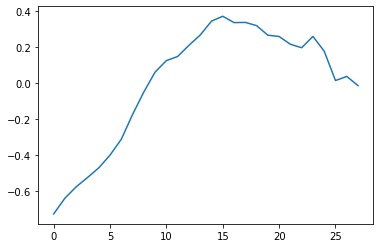

Minnesota


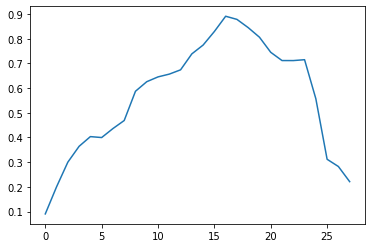

District of Columbia


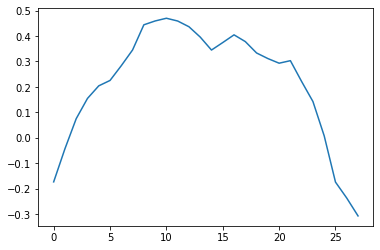

New Hampshire


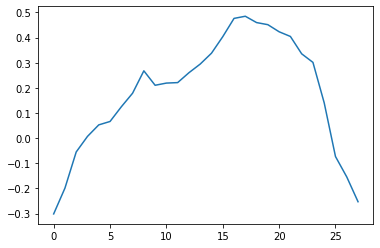

Hawaii


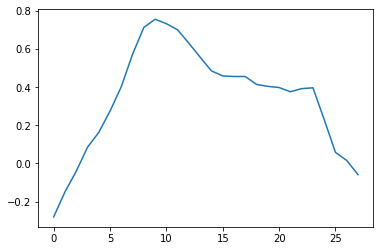

Kansas


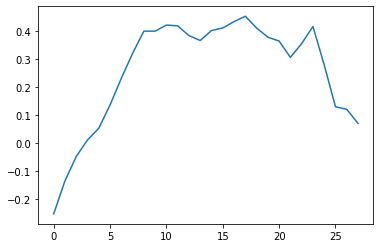

Maryland


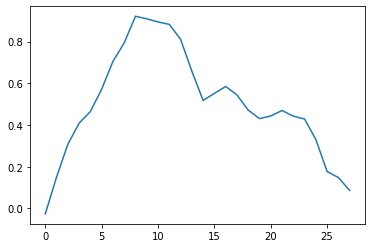

New Jersey


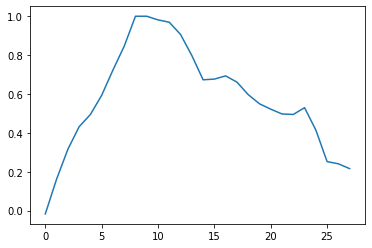

Oregon


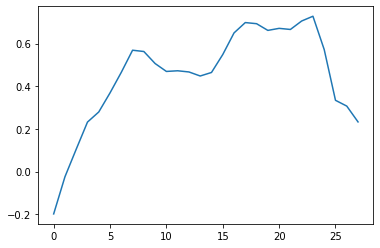

South Dakota


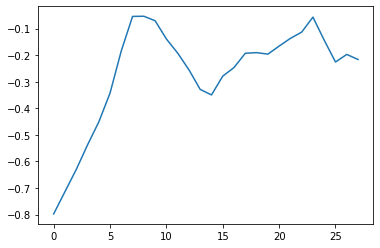

Iowa


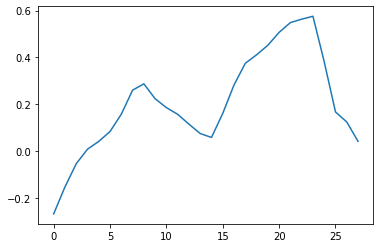

Mississippi


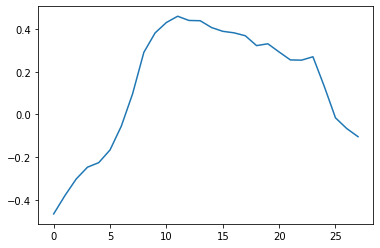

Louisiana


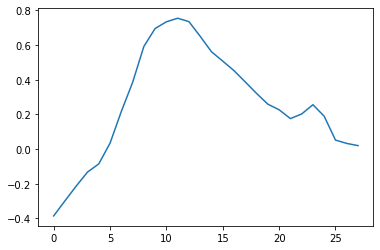

Rhode Island


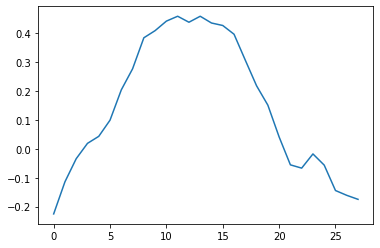

Utah


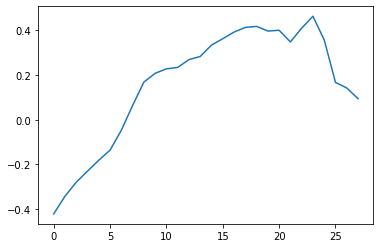

Massachusetts


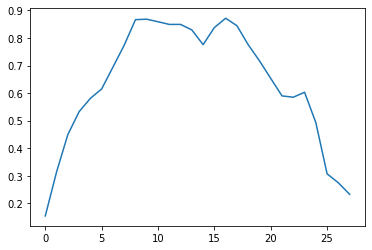

North Dakota


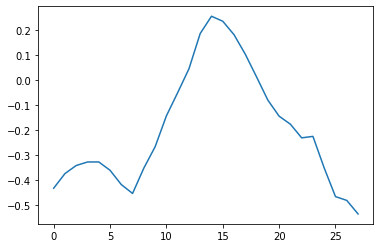

Nevada


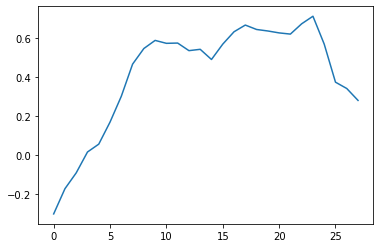

Tennessee


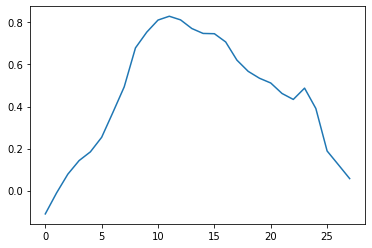

Delaware


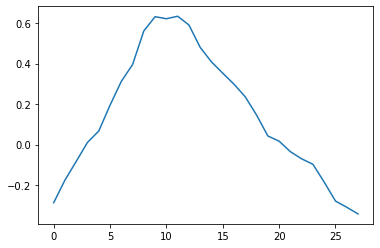

Montana


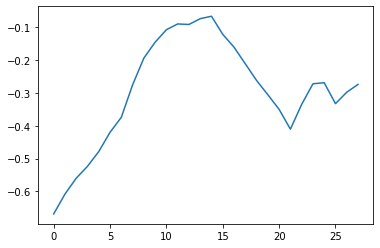

Nebraska


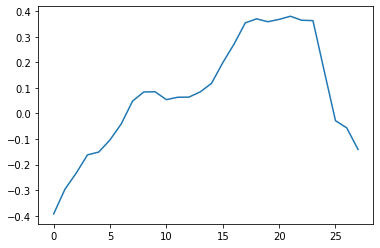

Connecticut


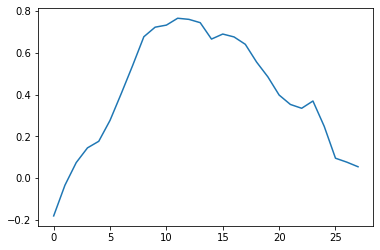

West Virginia


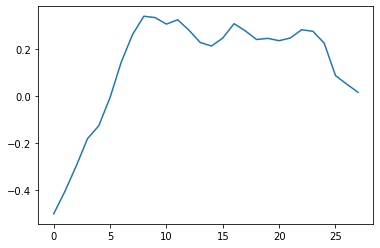

Alaska


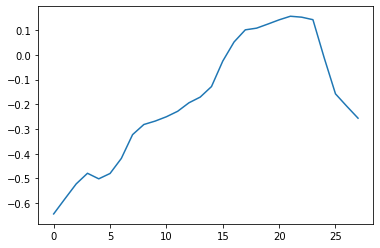

Maine


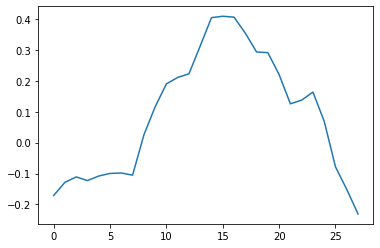

Arkansas


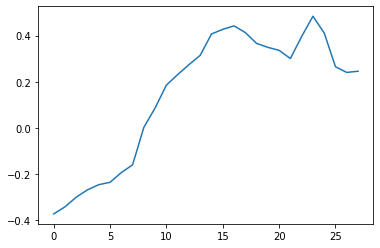

Colorado


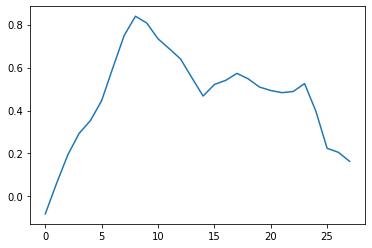

Oklahoma


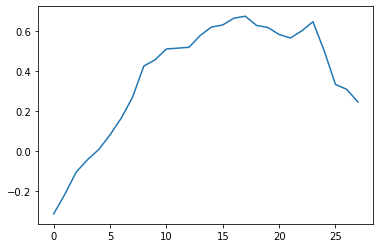

South Carolina


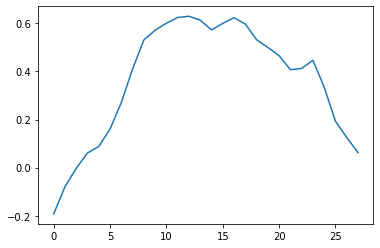

Wyoming


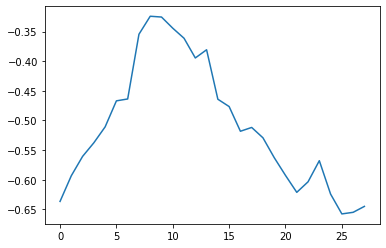

Georgia


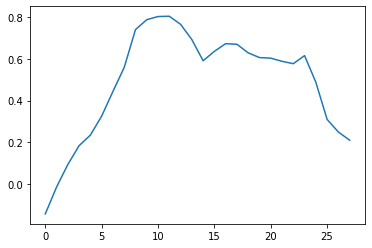

Pennsylvania


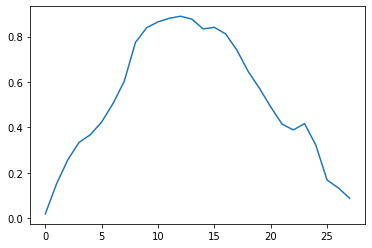

California


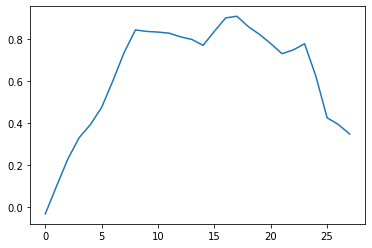

North Carolina


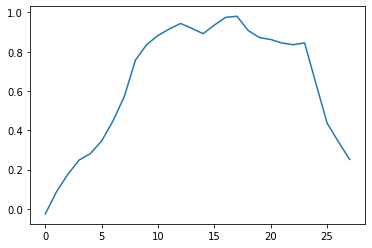

Missouri


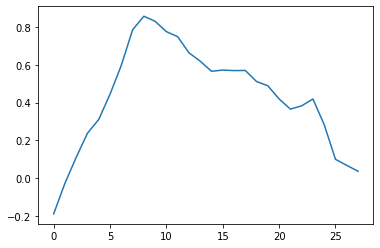

Washington


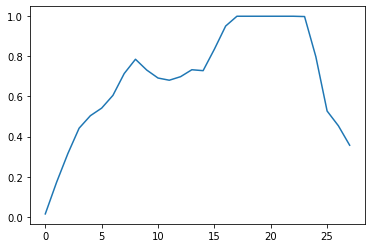

Texas


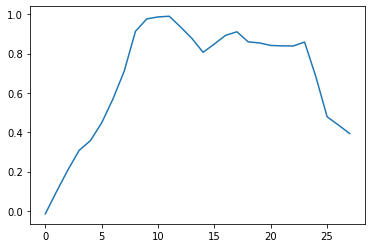

Florida


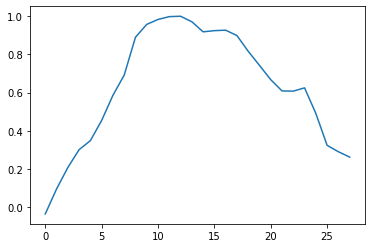

Wisconsin


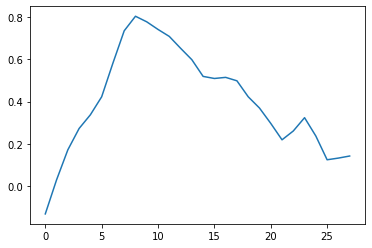

Ohio


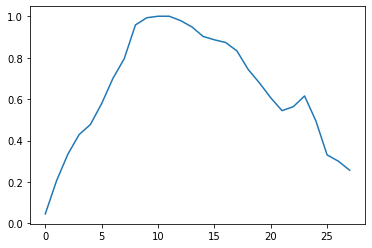

Michigan


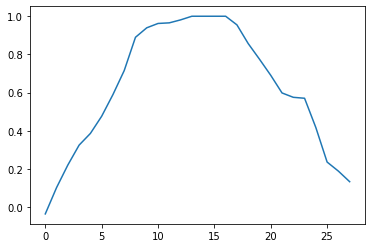

New York


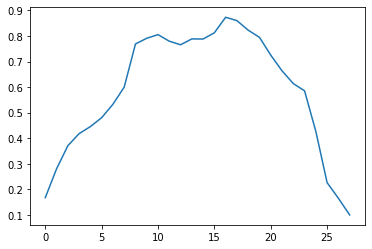

Illinois


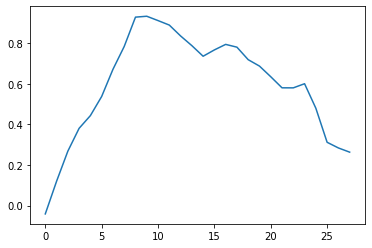

Indiana


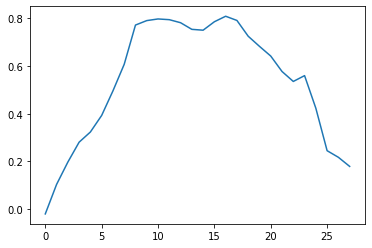

Virginia


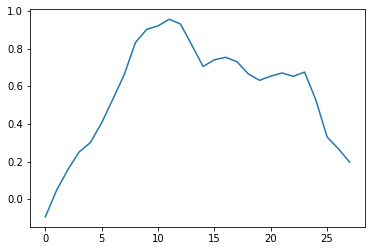

Alabama


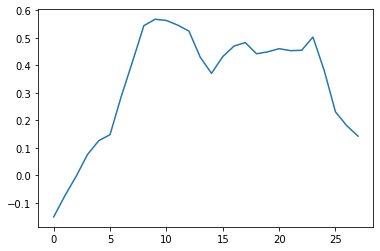

Arizona


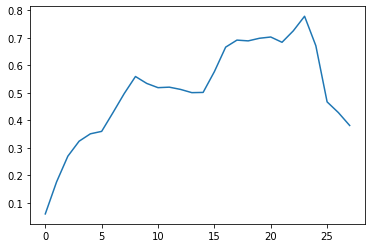

Kentucky


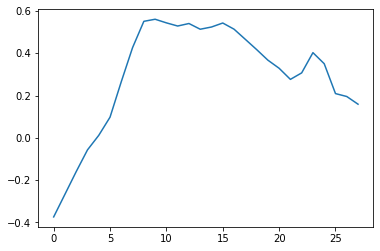

New Mexico


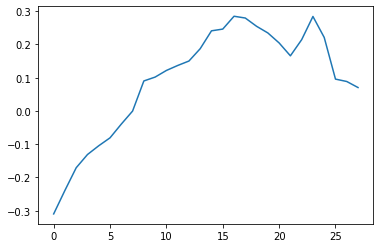

Vermont


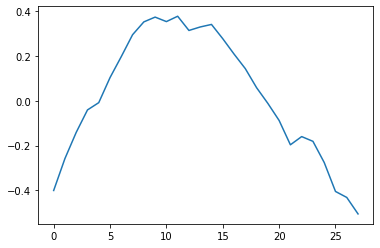

In [ ]:
dcol=[3+n*4 for n in range(0,28)]
input_test = test1[:,dcol]
input_test.shape

for i in range(len(states)):
  print(states[i])
  plt.plot(input_test[i])
  plt.show()

## 14-days forecast

In [ ]:
col_names_1 = ['date', 't+1_MAE', 't+2_MAE', 't+3_MAE', 't+4_MAE',
             't+5_MAE', 't+6_MAE', 't+7_MAE']
col_names_2 = ['date', 't+8_MAE', 't+9_MAE', 't+10_MAE', 't+11_MAE',
             't+12_MAE', 't+13_MAE', 't+14_MAE']
col_names_3 = ['date', 't+15_MAE', 't+16_MAE', 't+17_MAE', 't+18_MAE',
             't+19_MAE', 't+20_MAE', 't+21_MAE']
col_names_4 = ['date', 't+22_MAE', 't+23_MAE', 't+24_MAE', 't+25_MAE',
             't+26_MAE', 't+27_MAE', 't+28_MAE']


mae_df = DataFrame(columns = col_names_1)

forecasts_ql_4wk = []
inv_truth_v3_4wk = []
mae_list_v3_4wk = []
train_date = datetime(2022,2,7)

for n in range(1):
    for i in range(2):
        print(f'======================== {i+1} / 2 ========================')
        print(f'========= Current Date: {train_date + timedelta(days=(i+1)*14)} =========')
        wf_df = rate_df[rate_df.index >= (train_date - timedelta(days=30 * 15))]
        wf_df = wf_df[wf_df.index <= (train_date + timedelta(days=(i+1)*14))]
        # Configure
        n_features = 2
        n_lag = 7 * 4
        n_lag2 = 7
        
        n_out = 14
        n_test = 1# len(state_supervised) - 360 
        # test = 88 days
        # train = 354 days
        nth_week = i+1 # 
        n_seq = nth_week * 14

        # Prepare data
        scaler1, train1, test1 = prepare_all_state_data(states, wf_df, n_test=n_test,
                                  n_lag=n_lag, n_seq=n_seq, nth_week=nth_week,
                                  n_features=n_features, n_out=n_out, pred_id=0)
        
        train2, test2 = train1[:, -(n_lag2 * n_features+n_out):], test1[:, -(n_lag2 * n_features+n_out):]

        # # Clean up all data for validation
        train1 = train1[:-n_out*nth_week + 1]
        train2 = train2[:-n_out*nth_week + 1]
        # n_feature * n_lag + n_seq
        # 4         * 21    + 7     = 91
        print("=================================================")
        print('Train1: %s, Test: %s' % (train1.shape, test1.shape))
        print('Train2: %s, Test: %s' % (train2.shape, test2.shape))

    #     X, y = train1[:, 0:n_lag*n_features], train1[:, n_lag*n_features:]
    #     X = X.reshape(X.shape[0], 1, X.shape[1])

        ################ Quantile Loss ################
        model = fit_lstm_quantile(train1, train2, n_lag1=n_lag,
                                  n_lag2=n_lag2, n_features=n_features,
                                  n_out=n_out, n_batch=2**6, 
                                  nb_epoch=100, n_neurons=2**8,
                                  val = 0.05, val_1=None, val_2=None)
        
        ################ Save Model ################
        model.save(f'/content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/{str(train_date.date())}/week{i+1}_model214_11')
        
    #     ################ Huber loss ################
    #     # model = fit_lstm(train, n_lag=n_lag, n_features=n_features,
    #     #              n_seq=n_out, n_batch=2**6, nb_epoch=100, n_neurons=96)

        print('Model training completed!')
        print('Now making forecast!')
        forecasts = make_forecasts(model, n_batch=2**6, 
                                   test1=test1, test2 = test2,
                                   n_features=n_features,
                                   n_lag1=n_lag, n_lag2=n_lag2, n_seq=n_out)

        print('Inverse forecast to unscaled numbers!')
        # inverse transform forecasts and test
        forecasts_ql = []

        # inv_forecasts_v3, inv_truth_v3 = inverse_transform_all_state(test=test, forecasts=forecasts, 
        #                                                           scaler=scaler,n_lag=n_lag, 
        #                                                           n_features=n_features, n_seq=n_out, quantile_i=0)
            
        # for i in range(len(inv_forecasts_v3)):
        #     inv_forecasts_v3[i,] = inv_forecasts_v3[i,]/10000* state_pop[states[i]]['POPULATION']
        #     inv_truth_v3[i,] = inv_truth_v3[i,]/10000*state_pop[states[i]]['POPULATION']
        #     #print(i+1,'/', len(inv_forecasts_v3))
        # #print(inv_forecasts_v3.shape, inv_truth_v3.shape)

        # forecasts_ql.append(inv_forecasts_v3)
        # mae_list_v3 = evaluate_forecasts(test=inv_truth_v3, forecasts=inv_forecasts_v3, 
        #                     n_lag=n_lag, n_seq=n_out)

        for j in range(len(forecasts)):
          print('quantile_n:', j)
          if j == len(forecasts) // 2: 
            inv_forecasts_v3, inv_truth_v3 = inverse_transform_all_state(test=test1, forecasts=forecasts, 
                                                                  scaler=scaler1,n_lag=n_lag, 
                                                                  n_features=n_features, n_seq=n_out, quantile_i=j)
            
            for i in range(len(inv_forecasts_v3)):
                inv_forecasts_v3[i,] = inv_forecasts_v3[i,]/10000* state_pop[states[i]]['population']
                inv_truth_v3[i,] = inv_truth_v3[i,]/10000*state_pop[states[i]]['population']
                #print(i+1,'/', len(inv_forecasts_v3))
            #print(inv_forecasts_v3.shape, inv_truth_v3.shape)

            forecasts_ql.append(inv_forecasts_v3)

            mae_list_v3 = evaluate_forecasts(test=inv_truth_v3, forecasts=inv_forecasts_v3, 
                              n_lag=n_lag, n_seq=n_out)
          else:
            print('Not Median')
            inv_forecasts_v3, inv_truth_v3 = inverse_transform_all_state(test=test1, forecasts=forecasts, 
                                                                  scaler=scaler1,n_lag=n_lag, 
                                                                  n_features=n_features, n_seq=n_out, quantile_i=j)
            for i in range(len(inv_forecasts_v3)):
                inv_forecasts_v3[i,] = inv_forecasts_v3[i,]/10000* state_pop[states[i]]['population']
                inv_truth_v3[i,] = inv_truth_v3[i,]/10000*state_pop[states[i]]['population']
                #print(i+1,'/', len(inv_forecasts_v3))
            #print(inv_forecasts_v3.shape, inv_truth_v3.shape)

            forecasts_ql.append(inv_forecasts_v3)
        
        if nth_week == 1:
          forecasts_ql_4wk = forecasts_ql
          inv_truth_v3_4wk = inv_truth_v3
          mae_list_v3_4wk = mae_list_v3
        else:
          ## Concatenate 4 Weeks' forecasts
          inv_truth_v3_4wk = np.concatenate((inv_truth_v3_4wk, 
                                             inv_truth_v3), axis=1)
          mae_list_v3_4wk = mae_list_v3_4wk + mae_list_v3

          for q in range(len(forecasts_ql)):
            forecasts_ql_4wk[q] = np.concatenate((forecasts_ql_4wk[q], 
                                                  forecasts_ql[q]), axis=1)

        # new_row = [datetime(2021,11,8) + timedelta(days=i)] + mae_list_v3
        # mae_df.loc[len(mae_df)] = new_row
        #mae_df.to_csv('mae_1st_week_cont.csv')

    # ## Export i-th run to CSV file
    export_forecasts(inv_forecast=forecasts_ql_4wk, date=train_date,
                     n_seq=28, states_list=states, train_date=train_date)


======================== 1 / 2 ========================
========= Current Date: 2022-02-21 00:00:00 =========
Deleted rows:  14
Uncleaned Train shape:  (21573, 70)
Cleaned Train shape:  (20910, 70)
Concatenated Dataframe shape: (20961, 70)
[0.33974302 8.01473765 0.32455451 8.14983546 0.33494665 8.47359058
 0.33015027 9.16826512 0.33494665 9.25140224 0.33894362 8.98840117
 0.32695269 8.73499285 0.32055753 0.32215632 0.32135693 0.33254846
 0.33015027 0.32055753 0.31656055 0.31176418 0.30616841 0.28938111
 0.27339321 0.25420772 0.24381558 0.24941135]
Concatenated Dataframe shape of 1th week: (20961, 70)
[0.33974302 8.01473765 0.32455451 8.14983546 0.33494665 8.47359058
 0.33015027 9.16826512 0.33494665 9.25140224 0.33894362 8.98840117
 0.32695269 8.73499285 0.32055753 0.32215632 0.32135693 0.33254846
 0.33015027 0.32055753 0.31656055 0.31176418 0.30616841 0.28938111
 0.27339321 0.25420772 0.24381558 0.24941135]
Train1: (20897, 70), Test: (51, 70)
Train2: (20897, 28), Test: (51, 28)
23
W: 

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week1_model214_11/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week1_model214_11/assets


Model training completed!
Now making forecast!
Inverse forecast to unscaled numbers!
quantile_n: 0
Not Median
quantile_n: 1
Not Median
quantile_n: 2
Not Median
quantile_n: 3
Not Median
quantile_n: 4
Not Median
quantile_n: 5
Not Median
quantile_n: 6
Not Median
quantile_n: 7
Not Median
quantile_n: 8
Not Median
quantile_n: 9
Not Median
quantile_n: 10
Not Median
quantile_n: 11
t+1 MAE: 4.303125
t+1 MAPE: 2.507730
t+1 RMSE: 6.750041
t+2 MAE: 5.508721
t+2 MAPE: 3.653413
t+2 RMSE: 8.093952
t+3 MAE: 7.942081
t+3 MAPE: 4.934240
t+3 RMSE: 12.353337
t+4 MAE: 9.198411
t+4 MAPE: 5.860105
t+4 RMSE: 14.553933
t+5 MAE: 9.508558
t+5 MAPE: 6.183009
t+5 RMSE: 16.495075
t+6 MAE: 10.135195
t+6 MAPE: 8.025086
t+6 RMSE: 17.776039
t+7 MAE: 13.318916
t+7 MAPE: 9.992708
t+7 RMSE: 21.103617
t+8 MAE: 14.518000
t+8 MAPE: 11.791704
t+8 RMSE: 21.855588
t+9 MAE: 19.589592
t+9 MAPE: 15.437794
t+9 RMSE: 29.661709
t+10 MAE: 21.049011
t+10 MAPE: 17.431046
t+10 RMSE: 31.663930
t+11 MAE: 24.003561
t+11 MAPE: 20.811799
t+11

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week2_model214_11/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/2022-02-07/week2_model214_11/assets


Model training completed!
Now making forecast!
Inverse forecast to unscaled numbers!
quantile_n: 0
Not Median
quantile_n: 1
Not Median
quantile_n: 2
Not Median
quantile_n: 3
Not Median
quantile_n: 4
Not Median
quantile_n: 5
Not Median
quantile_n: 6
Not Median
quantile_n: 7
Not Median
quantile_n: 8
Not Median
quantile_n: 9
Not Median
quantile_n: 10
Not Median
quantile_n: 11
t+1 MAE: 41.834094
t+1 MAPE: 38.185898
t+1 RMSE: 67.084189
t+2 MAE: 41.581596
t+2 MAPE: 40.697081
t+2 RMSE: 65.784420
t+3 MAE: 45.145798
t+3 MAPE: 46.020925
t+3 RMSE: 72.421918
t+4 MAE: 42.916000
t+4 MAPE: 46.172450
t+4 RMSE: 71.718796
t+5 MAE: 38.716474
t+5 MAPE: 44.024454
t+5 RMSE: 63.231440
t+6 MAE: 42.771375
t+6 MAPE: 49.874812
t+6 RMSE: 69.475382
t+7 MAE: 44.888308
t+7 MAPE: 55.403850
t+7 RMSE: 71.476203
t+8 MAE: 45.980794
t+8 MAPE: 59.332177
t+8 RMSE: 73.873181
t+9 MAE: 48.128245
t+9 MAPE: 65.832098
t+9 RMSE: 75.709678
t+10 MAE: 44.779790
t+10 MAPE: 64.579513
t+10 RMSE: 70.231015
t+11 MAE: 46.039174
t+11 MAPE: 

In [ ]:
## Load the TensorBoard notebook extension
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
print('SUM MAE: ', sum(mae_list_v3_4wk))
for i in mae_list_v3_4wk:
  print(i)

SUM MAE:  850.6166112284654
4.303124540547909
5.508721431550849
7.9420809100323035
9.198410910636122
9.508557567412213
10.135195437334046
13.318915742596397
14.518000441414198
19.589591890146078
21.04901066596338
24.003560596101472
27.230746186546956
24.55519108901171
28.460801913354555
41.83409379157564
41.58159597924271
45.14579814388372
42.91599983586708
38.71647447389854
42.77137451980543
44.88830787058147
45.98079397835021
48.12824546341567
44.779790372532396
46.039173964780176
50.40839738219831
46.71104421567424
51.39361191401164


## 28-days forecast

In [ ]:
col_names_1 = ['date', 't+1_MAE', 't+2_MAE', 't+3_MAE', 't+4_MAE',
             't+5_MAE', 't+6_MAE', 't+7_MAE']
col_names_2 = ['date', 't+8_MAE', 't+9_MAE', 't+10_MAE', 't+11_MAE',
             't+12_MAE', 't+13_MAE', 't+14_MAE']
col_names_3 = ['date', 't+15_MAE', 't+16_MAE', 't+17_MAE', 't+18_MAE',
             't+19_MAE', 't+20_MAE', 't+21_MAE']
col_names_4 = ['date', 't+22_MAE', 't+23_MAE', 't+24_MAE', 't+25_MAE',
             't+26_MAE', 't+27_MAE', 't+28_MAE']


mae_df = DataFrame(columns = col_names_1)

forecasts_ql_4wk = []
inv_truth_v3_4wk = []
mae_list_v3_4wk = []
train_date = datetime(2022,1,24)

for n in range(1):
    for i in range(1):
        print(f'======================== {i+1} / 1 ========================')
        print(f'========= Current Date: {train_date + timedelta(days=(i+1)*28)} =========')
        wf_df = rate_df[rate_df.index >= (train_date - timedelta(days=30 * 15))]
        wf_df = wf_df[wf_df.index <= (train_date + timedelta(days=(i+1)*28))]
        # Configure
        n_features = 2
        n_lag = 7 * 4
        n_lag2 = 7
        
        n_out = 28
        n_test = 1# len(state_supervised) - 360 
        # test = 88 days
        # train = 354 days
        nth_week = i+1 # 
        n_seq = nth_week * 28

        # Prepare data
        scaler1, train1, test1 = prepare_all_state_data(states, wf_df, n_test=n_test,
                                  n_lag=n_lag, n_seq=n_seq, nth_week=nth_week,
                                  n_features=n_features, n_out=n_out, pred_id=0)
        
        train2, test2 = train1[:, -(n_lag2 * n_features+n_out):], test1[:, -(n_lag2 * n_features+n_out):]

        # # Clean up all data for validation
        train1 = train1[:-n_out*nth_week + 1]
        train2 = train2[:-n_out*nth_week + 1]
        # n_feature * n_lag + n_seq
        # 4         * 21    + 7     = 91
        print("=================================================")
        print('Train1: %s, Test: %s' % (train1.shape, test1.shape))
        print('Train2: %s, Test: %s' % (train2.shape, test2.shape))

    #     X, y = train1[:, 0:n_lag*n_features], train1[:, n_lag*n_features:]
    #     X = X.reshape(X.shape[0], 1, X.shape[1])

        ################ Quantile Loss ################
        model = fit_lstm_quantile(train1, train2, n_lag1=n_lag,
                                  n_lag2=n_lag2, n_features=n_features,
                                  n_out=n_out, n_batch=2**6, 
                                  nb_epoch=100, n_neurons=2**8,
                                  val = 0.05)
        
        ################ Save Model ################
        model.save(f'/content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph)/{str(train_date.date())}/week{i+1}_model28_15')
        
    #     ################ Huber loss ################
    #     # model = fit_lstm(train, n_lag=n_lag, n_features=n_features,
    #     #              n_seq=n_out, n_batch=2**6, nb_epoch=100, n_neurons=96)

        print('Model training completed!')
        print('Now making forecast!')
        forecasts = make_forecasts(model, n_batch=2**6, test1=test1, 
                                   test2 = test2,
                                    n_features=n_features,
                                    n_lag1=n_lag, n_lag2=n_lag2, n_seq=n_out)

        print('Inverse forecast to unscaled numbers!')
        # inverse transform forecasts and test
        forecasts_ql = []

        # inv_forecasts_v3, inv_truth_v3 = inverse_transform_all_state(test=test, forecasts=forecasts, 
        #                                                           scaler=scaler,n_lag=n_lag, 
        #                                                           n_features=n_features, n_seq=n_out, quantile_i=0)
            
        # for i in range(len(inv_forecasts_v3)):
        #     inv_forecasts_v3[i,] = inv_forecasts_v3[i,]/10000* state_pop[states[i]]['POPULATION']
        #     inv_truth_v3[i,] = inv_truth_v3[i,]/10000*state_pop[states[i]]['POPULATION']
        #     #print(i+1,'/', len(inv_forecasts_v3))
        # #print(inv_forecasts_v3.shape, inv_truth_v3.shape)

        # forecasts_ql.append(inv_forecasts_v3)
        # mae_list_v3 = evaluate_forecasts(test=inv_truth_v3, forecasts=inv_forecasts_v3, 
        #                     n_lag=n_lag, n_seq=n_out)

        for j in range(len(forecasts)):
          print('quantile_n:', j)
          if j == len(forecasts) // 2: 
            inv_forecasts_v3, inv_truth_v3 = inverse_transform_all_state(test=test1, forecasts=forecasts, 
                                                                  scaler=scaler1,n_lag=n_lag, 
                                                                  n_features=n_features, n_seq=n_out, quantile_i=j)
            
            for i in range(len(inv_forecasts_v3)):
                inv_forecasts_v3[i,] = inv_forecasts_v3[i,]/10000* state_pop[states[i]]['population']
                inv_truth_v3[i,] = inv_truth_v3[i,]/10000*state_pop[states[i]]['population']
                #print(i+1,'/', len(inv_forecasts_v3))
            #print(inv_forecasts_v3.shape, inv_truth_v3.shape)

            forecasts_ql.append(inv_forecasts_v3)

            mae_list_v3 = evaluate_forecasts(test=inv_truth_v3, forecasts=inv_forecasts_v3, 
                              n_lag=n_lag, n_seq=n_out)
          else:
            print('Not Median')
            inv_forecasts_v3, inv_truth_v3 = inverse_transform_all_state(test=test1, forecasts=forecasts, 
                                                                  scaler=scaler1,n_lag=n_lag, 
                                                                  n_features=n_features, n_seq=n_out, quantile_i=j)
            for i in range(len(inv_forecasts_v3)):
                inv_forecasts_v3[i,] = inv_forecasts_v3[i,]/10000* state_pop[states[i]]['population']
                inv_truth_v3[i,] = inv_truth_v3[i,]/10000*state_pop[states[i]]['population']
                #print(i+1,'/', len(inv_forecasts_v3))
            #print(inv_forecasts_v3.shape, inv_truth_v3.shape)

            forecasts_ql.append(inv_forecasts_v3)
        
        if nth_week == 1:
          forecasts_ql_4wk = forecasts_ql
          inv_truth_v3_4wk = inv_truth_v3
          mae_list_v3_4wk = mae_list_v3
        else:
          ## Concatenate 4 Weeks' forecasts
          inv_truth_v3_4wk = np.concatenate((inv_truth_v3_4wk, 
                                             inv_truth_v3), axis=1)
          mae_list_v3_4wk = mae_list_v3_4wk + mae_list_v3

          for q in range(len(forecasts_ql)):
            forecasts_ql_4wk[q] = np.concatenate((forecasts_ql_4wk[q], 
                                                  forecasts_ql[q]), axis=1)

        # new_row = [datetime(2021,11,8) + timedelta(days=i)] + mae_list_v3
        # mae_df.loc[len(mae_df)] = new_row
        #mae_df.to_csv('mae_1st_week_cont.csv')

    # ## Export i-th run to CSV file
    export_forecasts(inv_forecast=forecasts_ql_4wk, date=train_date,
                     n_seq=28, states_list=states, train_date=train_date)



======================== 1 / 1 ========================
========= Current Date: 2022-02-21 00:00:00 =========
Deleted rows:  28
Uncleaned Train shape:  (21573, 84)
Cleaned Train shape:  (20196, 84)
Concatenated Dataframe shape: (20247, 84)
[0.29817446 7.42158631 0.29417748 7.28808729 0.29497688 7.75173659
 0.29737507 7.44556817 0.31416237 7.75333538 0.30456962 7.96677393
 0.31016539 7.60784543 0.32295572 7.52071133 0.33174907 7.79090696
 0.33574604 7.67819222 0.33734483 8.04831226 0.32775209 6.81484525
 0.35013516 6.98351767 0.35573093 7.05546325 0.36212609 0.3765152
 0.3605273  0.35333274 0.35573093 0.35173395 0.34933576 0.33974302
 0.32455451 0.33494665 0.33015027 0.33494665 0.33894362 0.32695269
 0.32055753 0.32215632 0.32135693 0.33254846 0.33015027 0.32055753
 0.31656055 0.31176418 0.30616841 0.28938111 0.27339321 0.25420772
 0.24381558 0.24941135]
Concatenated Dataframe shape of 1th week: (20247, 84)
[0.29817446 7.42158631 0.29417748 7.28808729 0.29497688 7.75173659
 0.29737507 7

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph))/2022-01-24/week1_model28_15/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Omicron_evaluation_15month(non-sph))/2022-01-24/week1_model28_15/assets


Model training completed!
Now making forecast!
Inverse forecast to unscaled numbers!
quantile_n: 0
Not Median
quantile_n: 1
Not Median
quantile_n: 2
Not Median
quantile_n: 3
Not Median
quantile_n: 4
Not Median
quantile_n: 5
Not Median
quantile_n: 6
Not Median
quantile_n: 7
Not Median
quantile_n: 8
Not Median
quantile_n: 9
Not Median
quantile_n: 10
Not Median
quantile_n: 11
t+1 MAE: 96.311569
t+1 MAPE: 30.483215
t+1 RMSE: 150.529812
t+2 MAE: 101.933680
t+2 MAPE: 31.880613
t+2 RMSE: 158.680514
t+3 MAE: 99.313125
t+3 MAPE: 32.034030
t+3 RMSE: 155.296416
t+4 MAE: 108.690288
t+4 MAPE: 35.048529
t+4 RMSE: 171.346042
t+5 MAE: 107.484375
t+5 MAPE: 35.667479
t+5 RMSE: 168.644520
t+6 MAE: 117.220597
t+6 MAPE: 39.741088
t+6 RMSE: 183.168051
t+7 MAE: 130.464596
t+7 MAPE: 45.047386
t+7 RMSE: 203.534377
t+8 MAE: 129.445535
t+8 MAPE: 46.610390
t+8 RMSE: 200.623308
t+9 MAE: 129.735758
t+9 MAPE: 48.101232
t+9 RMSE: 200.582635
t+10 MAE: 147.149634
t+10 MAPE: 55.687952
t+10 RMSE: 226.418935
t+11 MAE: 151

In [ ]:
print('SUM MAE: ', sum(mae_list_v3_4wk))
for i in mae_list_v3_4wk:
  print(i)

SUM MAE:  4395.598923783524
96.31156943035171
101.93367991040078
99.31312526347683
108.69028837390877
107.48437531370237
117.22059737617907
130.46459582133556
129.44553548807048
129.73575779112323
147.149634055291
151.5803190472727
158.50504599231581
159.1438776179725
166.64018038581287
169.54301988785667
180.3749125820187
168.31574784155436
174.45659655261693
178.40971192304394
179.2199996249423
187.4399320371746
192.9923909097087
196.00562980056915
189.6522871266516
195.61226363270725
190.50844688534127
196.70816236324137
192.7412407488831


## Comparing to other model

Compare to Hub's Ensemble Model

In [ ]:
hub_df = read_csv('https://github.com/reichlab/covid19-forecast-hub/blob/master/data-processed/COVIDhub-4_week_ensemble/2022-01-31-COVIDhub-4_week_ensemble.csv?raw=true',
                  parse_dates=['target_end_date'])
hub_trained_df = read_csv('https://github.com/reichlab/covid19-forecast-hub/blob/master/data-processed/COVIDhub-trained_ensemble/2022-01-31-COVIDhub-trained_ensemble.csv?raw=true',
                          parse_dates=['target_end_date'])

fip_state = {
   "01": "Alabama",
   "02": "Alaska",
   "04": "Arizona",
   "05": "Arkansas",
   "06": "California",
   "08": "Colorado",
   "09": "Connecticut",
   "10": "Delaware",
   "11": "District of Columbia",
   "12": "Florida",
   "13": "Georgia",
   "15": "Hawaii",
   "16": "Idaho",
   "17": "Illinois",
   "18": "Indiana",
   "19": "Iowa",
   "20": "Kansas",
   "21": "Kentucky",
   "22": "Louisiana",
   "23": "Maine",
   "24": "Maryland",
   "25": "Massachusetts",
   "26": "Michigan",
   "27": "Minnesota",
   "28": "Mississippi",
   "29": "Missouri",
   "30": "Montana",
   "31": "Nebraska",
   "32": "Nevada",
   "33": "New Hampshire",
   "34": "New Jersey",
   "35": "New Mexico",
   "36": "New York",
   "37": "North Carolina",
   "38": "North Dakota",
   "39": "Ohio",
   "40": "Oklahoma",
   "41": "Oregon",
   "42": "Pennsylvania",
   "44": "Rhode Island",
   "45": "South Carolina",
   "46": "South Dakota",
   "47": "Tennessee",
   "48": "Texas",
   "49": "Utah",
   "50": "Vermont",
   "51": "Virginia",
   "53": "Washington",
   "54": "West Virginia",
   "55": "Wisconsin",
   "56": "Wyoming"
}

In [ ]:
hub_df = hub_df[hub_df['target'].str.contains('hosp')]
hub_df['location'] = hub_df['location'].map(fip_state)

hub_trained_df = hub_trained_df[hub_trained_df['target'].str.contains('hosp')]
hub_trained_df['location'] = hub_trained_df['location'].map(fip_state)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [ ]:
ensemble_forecast = np.empty([forecasts_ql_4wk[0].shape[0],
                              forecasts_ql_4wk[0].shape[1]])
for i in range(inv_forecasts_v3.shape[0]):
    print(i+1,'/',inv_forecasts_v3.shape[0])
    print(f'Current Steta: {states[i]}')
    state_hub_df = hub_df[(hub_df['location']==states[i])&(hub_df['quantile'].isnull())]
    state_hub_df = state_hub_df[hub_df['target_end_date']>=train_date+timedelta(days=1)]
    state_hub_df = state_hub_df[hub_df['target_end_date']<=train_date+timedelta(days=29)]
    #print(len(state_hub_df['value'].tolist()))
    ensemble_forecast[i,] = state_hub_df['value'].tolist()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


1 / 51
Current Steta: Idaho
2 / 51
Current Steta: Minnesota
3 / 51
Current Steta: District of Columbia
4 / 51
Current Steta: New Hampshire
5 / 51
Current Steta: Hawaii
6 / 51
Current Steta: Kansas
7 / 51
Current Steta: Maryland
8 / 51
Current Steta: New Jersey
9 / 51
Current Steta: Oregon
10 / 51
Current Steta: South Dakota
11 / 51
Current Steta: Iowa
12 / 51
Current Steta: Mississippi
13 / 51
Current Steta: Louisiana
14 / 51
Current Steta: Rhode Island
15 / 51
Current Steta: Utah
16 / 51
Current Steta: Massachusetts
17 / 51
Current Steta: North Dakota
18 / 51
Current Steta: Nevada
19 / 51
Current Steta: Tennessee
20 / 51
Current Steta: Delaware
21 / 51
Current Steta: Montana
22 / 51
Current Steta: Nebraska
23 / 51
Current Steta: Connecticut
24 / 51
Current Steta: West Virginia
25 / 51
Current Steta: Alaska
26 / 51
Current Steta: Maine
27 / 51
Current Steta: Arkansas
28 / 51
Current Steta: Colorado
29 / 51
Current Steta: Oklahoma
30 / 51
Current Steta: South Carolina
31 / 51
Current St

In [ ]:
ensemble_trained_forecast = np.empty([forecasts_ql_4wk[0].shape[0],
                                      forecasts_ql_4wk[0].shape[1]])
for i in range(inv_forecasts_v3.shape[0]):
    print(i+1,'/',inv_forecasts_v3.shape[0])
    #print(f'Current Steta: {states[i]}')
    state_hub_trained_df = hub_trained_df[(hub_trained_df['location']==states[i])&(hub_trained_df['quantile'].isnull())]
    state_hub_trained_df = state_hub_trained_df[hub_trained_df['target_end_date']>=train_date+timedelta(days=1)]
    state_hub_trained_df = state_hub_trained_df[hub_trained_df['target_end_date']<=train_date+timedelta(days=29)]
    #print(state_hub_df['value'].tolist())
    ensemble_trained_forecast[i,] = state_hub_trained_df['value'].tolist()

1 / 51
2 / 51
3 / 51
4 / 51
5 / 51
6 / 51
7 / 51
8 / 51
9 / 51
10 / 51
11 / 51
12 / 51
13 / 51
14 / 51
15 / 51
16 / 51
17 / 51
18 / 51
19 / 51
20 / 51
21 / 51
22 / 51
23 / 51
24 / 51
25 / 51
26 / 51
27 / 51
28 / 51
29 / 51


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


30 / 51
31 / 51
32 / 51
33 / 51
34 / 51
35 / 51
36 / 51
37 / 51
38 / 51
39 / 51
40 / 51
41 / 51
42 / 51
43 / 51
44 / 51
45 / 51
46 / 51
47 / 51
48 / 51
49 / 51
50 / 51
51 / 51


In [ ]:
mae_list_ensemble = evaluate_forecasts(test=inv_truth_v3_4wk,
                                       forecasts=ensemble_forecast, 
                                       n_lag=n_lag, n_seq=28)
mae_list_ensemble_trained = evaluate_forecasts(test=inv_truth_v3_4wk,
                                               forecasts=ensemble_trained_forecast, 
                                               n_lag=n_lag, n_seq=28)

mae_comp_df = DataFrame({'Rate-SLSTM': mae_list_v3_4wk,
                         'Trained_Ensemble': mae_list_ensemble_trained,
                         'Ensemble': mae_list_ensemble
                         })
mae_comp_df.index = ['1-04', '1-05', '1-06', '1-07', '1-08', '1-09', '1-10',
                     '1-11', '1-12', '1-13', '1-14', '1-15', '1-16', '1-17',
                     '1-18', '1-19', '1-20', '1-21', '1-22', '1-23', '1-24',
                     '1-25', '1-26', '1-27', '1-28', '1-29', '1-30', '1-31']

t+1 MAE: 25.350140
t+1 MAPE: 8.999336
t+1 RMSE: 40.841616
t+2 MAE: 33.406162
t+2 MAPE: 11.637468
t+2 RMSE: 52.691587
t+3 MAE: 43.322129
t+3 MAPE: 15.661827
t+3 RMSE: 68.899925
t+4 MAE: 47.221289
t+4 MAPE: 18.314468
t+4 RMSE: 74.719232
t+5 MAE: 41.873950
t+5 MAPE: 17.668733
t+5 RMSE: 67.702191
t+6 MAE: 45.028011
t+6 MAPE: 19.154664
t+6 RMSE: 73.134057
t+7 MAE: 65.582633
t+7 MAPE: 27.550085
t+7 RMSE: 107.988912
t+8 MAE: 71.927171
t+8 MAPE: 31.395387
t+8 RMSE: 116.648513
t+9 MAE: 76.098039
t+9 MAPE: 35.731904
t+9 RMSE: 122.723106
t+10 MAE: 79.005602
t+10 MAPE: 39.019086
t+10 RMSE: 126.744504
t+11 MAE: 80.568627
t+11 MAPE: 41.619294
t+11 RMSE: 130.619414
t+12 MAE: 76.554622
t+12 MAPE: 41.414823
t+12 RMSE: 126.690733
t+13 MAE: 76.736695
t+13 MAPE: 43.786487
t+13 RMSE: 122.936680
t+14 MAE: 93.232493
t+14 MAPE: 55.626454
t+14 RMSE: 146.905108
t+15 MAE: 101.338936
t+15 MAPE: 63.648571
t+15 RMSE: 160.851068
t+16 MAE: 103.131653
t+16 MAPE: 67.838492
t+16 RMSE: 166.061281
t+17 MAE: 105.798319
t+1

In [ ]:
mae_comp_df = DataFrame({'SLSTM': mae_list_v3_4wk,
                         'Trained_Ensemble': mae_list_ensemble_trained,
                         'Ensemble': mae_list_ensemble
                         })
mae_comp_df.index = [(train_date + timedelta(days=i)).date() for i in range(1, 29)]

In [ ]:
import matplotlib.pyplot as plt

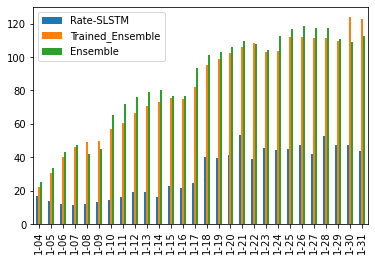

In [ ]:
mae_comp_df.plot(kind='bar', stacked=False)

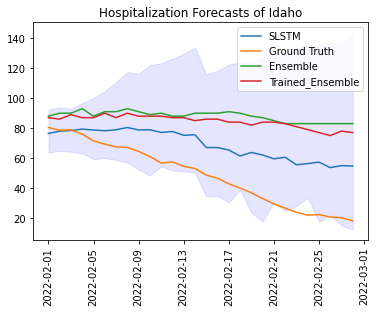

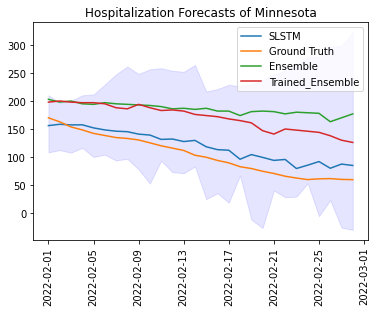

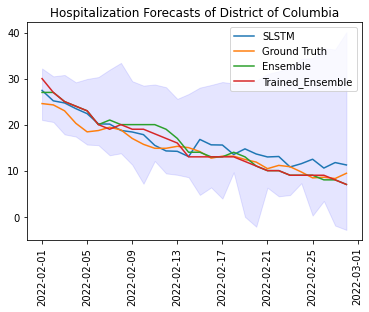

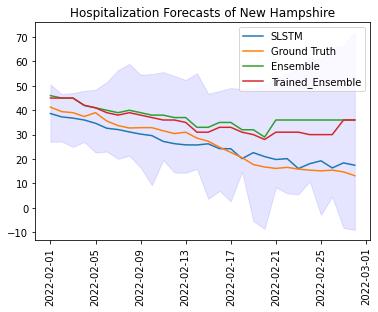

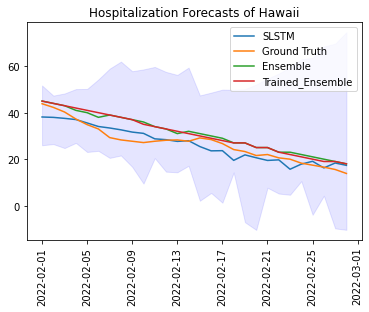

...

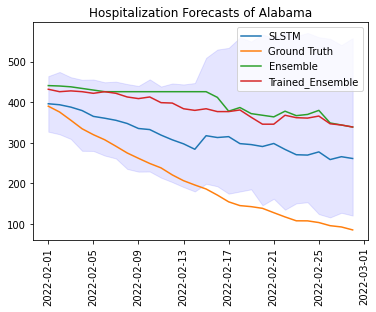

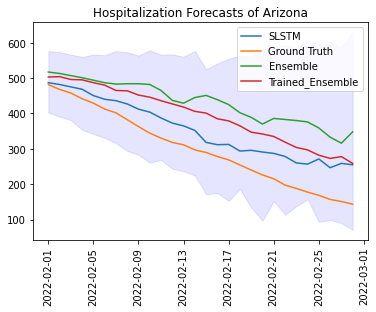

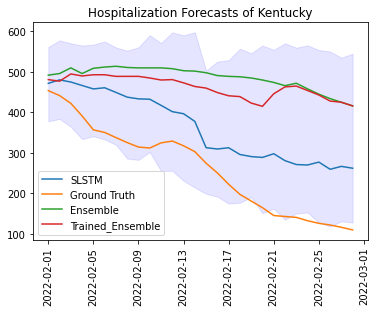

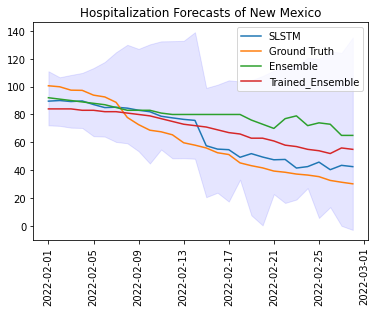

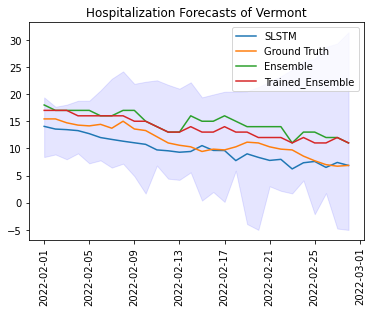

In [ ]:
state_idx_list = [26, 45, 49]
quantile_len = len(forecasts_ql)

col_label_3 = ['Date'] + [(train_date + timedelta(days=i)).date() for i in range(1, 29)]

for idx in range(len(states)):
  LSTM_v3_line_CO = forecasts_ql_4wk[quantile_len//2][idx]
  LSTM_v3_line_CO_low = forecasts_ql_4wk[0][idx]
  LSTM_v3_line_CO_up = forecasts_ql_4wk[-1][idx]
  ensemble_line_CO = ensemble_forecast[idx]
  trained_ensemble_line_CO = ensemble_trained_forecast[idx]

  plt.plot(col_label_3[1:],LSTM_v3_line_CO, label='SLSTM')
  plt.plot(col_label_3[1:], inv_truth_v3_4wk[idx], label='Ground Truth')
  plt.plot(col_label_3[1:], ensemble_line_CO, label='Ensemble')
  plt.plot(col_label_3[1:],trained_ensemble_line_CO, label='Trained_Ensemble')
  plt.fill_between(col_label_3[1:], LSTM_v3_line_CO_low, LSTM_v3_line_CO_up, 
                  color='b', alpha=0.1)
  plt.title(f'Hospitalization Forecasts of {states[idx]}')
  plt.xticks(rotation=90)
  plt.legend()

  #images_dir = '/content/gdrive/MyDrive/RS-LSTM_images/2022-01-03_multi-lag_6months/Run_2'
  #plt.savefig(f'{images_dir}/{states[idx]}_2022-01-03.png')
  plt.show()